## Oxford Pets

In this project we will create image object detection models using:

* base model Xception (single object detection)
* base model MobileNetV2 (single object detection)
* Keras implementation of RetinaNet object detection (single/multiple object detection)

We will use The Oxford-IIIT Pet Dataset from https://www.kaggle.com/devdgohil/the-oxfordiiit-pet-dataset.

It is a 37 category pet dataset with roughly 100 images for each class created by the Visual Geometry Group at Oxford. 

## Setup, Imports & Data Download


In [0]:
SETUP = True

In [0]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

In [0]:
import os

try:
    %tensorflow_version 2.x
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    %matplotlib inline
except:
    %load_ext lab_black
    os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
    os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [0]:
!pip install -q -U toai

In [0]:
print(__import__('toai').__version__)
print(__import__('tensorflow').__version__)

0.4.1
2.1.0


In [0]:
from toai.imports import *
from toai.image import ImageAugmentor, ImageParser, ImageResizer, ImageDataContainer
from toai.data.utils import split_df
from toai.encode import CategoricalEncoder
from typing import *
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models  import load_model
from glob import glob
from matplotlib.patches import Rectangle
import xml.etree.ElementTree as ET
from sklearn.preprocessing import LabelEncoder

%matplotlib inline

In [0]:
DATA_DIR = Path('data/pets')
DATA_DIR.mkdir(parents=True, exist_ok=True)

In [0]:
TEMP_DIR = Path('.drive/My Drive/Projects/16_Advanced_CV/temp/pets')

In [0]:
def setup_kaggle():
    !rm -rf /root/.kaggle
    x = !ls kaggle.json
    assert x == ['kaggle.json'], 'Upload kaggle.json'
    !mkdir /root/.kaggle
    !mv kaggle.json /root/.kaggle
    !chmod 600 /root/.kaggle/kaggle.json
    
setup_kaggle()

In [0]:
DOWNLOAD_DATA = True

if DOWNLOAD_DATA:
    !kaggle datasets download -q -d devdgohil/the-oxfordiiit-pet-dataset --unzip -p {str(DATA_DIR)}

In [0]:
if SETUP:
    for filename in glob(str(DATA_DIR / '**/*.jpg'), recursive=True):
        try:
            shutil.move(filename, DATA_DIR)
        except:
            pass
    shutil.rmtree(DATA_DIR / 'images')

## Creating Dataset From XML Files. EDA

In [0]:
df_cols = ['filename', 'xmin', 'xmax','ymin', 'ymax',  'width', 'height', 'depth', 'name']

In [0]:
annotations = sorted(os.listdir(DATA_DIR/'annotations/annotations/xmls'))

In [0]:
len(annotations)

3686

In [0]:
df = pd.DataFrame(columns = df_cols)

In [0]:
for xml_file in progress_bar(annotations):
    tree = ET.parse(str(DATA_DIR/'annotations/annotations/xmls/') + '/' + xml_file)
    root = tree.getroot()

    for node in root:
        filename = tree.getroot().findall('.//filename')[0].text
        xmin = int(tree.getroot().findall('.//xmin')[0].text)
        xmax = int(tree.getroot().findall('.//xmax')[0].text)
        ymin = int(tree.getroot().findall('.//ymin')[0].text)
        ymax = int(tree.getroot().findall('.//ymax')[0].text)
        width = int(tree.getroot().findall('.//width')[0].text)
        height= int(tree.getroot().findall('.//height')[0].text)
        depth= int(tree.getroot().findall('.//depth')[0].text)
        name= tree.getroot().findall('.//name')[0].text
    df = df.append(pd.Series([filename, xmin, xmax,ymin, ymax, width, height, depth, name],index = df_cols), ignore_index = True)

In [0]:
df.head(3)

,filename,xmin,xmax,ymin,ymax,width,height,depth,name
0,Abyssinian_1.jpg,333,425,72,158,600,400,3,cat
1,Abyssinian_10.jpg,72,288,105,291,375,500,3,cat
2,Abyssinian_100.jpg,151,335,71,267,394,500,3,cat


In [0]:
df.describe()

,filename,xmin,xmax,ymin,ymax,width,height,depth,name
count,3686,3686,3686,3686,3686,3686,3686,3686,3686
unique,3686,363,429,242,393,292,319,1,2
top,japanese_chin_108.jpg,1,319,1,231,500,500,3,dog
freq,1,52,27,269,28,2011,938,3686,2498


In [0]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3686 entries, 0 to 3685
Data columns (total 9 columns):
filename    3686 non-null object
xmin        3686 non-null object
xmax        3686 non-null object
ymin        3686 non-null object
ymax        3686 non-null object
width       3686 non-null object
height      3686 non-null object
depth       3686 non-null object
name        3686 non-null object
dtypes: object(9)
memory usage: 259.3+ KB


In [0]:
df['x0'] = df['xmin'] / df['width']
df['x1'] = df['xmax'] / df['width']
df['y0'] = df['ymin'] / df['height']
df['y1'] = df['ymax'] / df['height']

In [0]:
df['object_width'] = df['x1'] - df['x0']
df['object_height'] = df['y1'] - df['y0']

In [0]:
df['file_path'] = f"{DATA_DIR}/' + df['filename']'

In [0]:
df = df[df['file_path'].apply(lambda x: Path(x).is_file())]

In [0]:
df['breed'] = df['filename'].apply(lambda x: x.rsplit('_', 1)[0])

In [0]:
# Cat breeds start in upper case, dog breeds - in lower case
df.breed.unique()

array(['Abyssinian', 'Bengal', 'Birman', 'Bombay', 'British_Shorthair',
       'Egyptian_Mau', 'Maine_Coon', 'Persian', 'Ragdoll', 'Russian_Blue',
       'Siamese', 'Sphynx', 'american_bulldog',
       'american_pit_bull_terrier', 'basset_hound', 'beagle', 'boxer',
       'chihuahua', 'english_cocker_spaniel', 'english_setter',
       'german_shorthaired', 'great_pyrenees', 'havanese',
       'japanese_chin', 'keeshond', 'leonberger', 'miniature_pinscher',
       'newfoundland', 'pomeranian', 'pug', 'saint_bernard', 'samoyed',
       'scottish_terrier', 'shiba_inu', 'staffordshire_bull_terrier',
       'wheaten_terrier', 'yorkshire_terrier'], dtype=object)

In [0]:
# Encoding 37 breeds
le = LabelEncoder()

In [0]:
le.fit(df['breed'])

LabelEncoder()

In [0]:
joblib.dump(le, TEMP_DIR / 'le.pickle')

In [0]:
le = joblib.load( TEMP_DIR / 'le.pickle')

In [0]:
df['breed_encoded'] = le.transform(df['breed'])

In [0]:
# Encoding names (cat/dog)
le_name = LabelEncoder()

In [0]:
le_name.fit(df['name'])

LabelEncoder()

In [0]:
joblib.dump(le_name, TEMP_DIR / 'le_name.pickle')

In [0]:
le_name = joblib.load( TEMP_DIR / 'le_name.pickle')

In [0]:
df['name_encoded'] = le_name.transform(df['name'])

In [0]:
df.sample(3)

,filename,xmin,xmax,ymin,ymax,width,height,depth,name,x0,x1,y0,y1,object_width,object_height,file_path,breed,breed_encoded,name_encoded
2184,great_pyrenees_187.jpg,186,284,101,186,500,375,3,dog,0.372000,0.568000,0.269333,0.496000,0.196000,0.226667,data/pets/great_pyrenees_187.jpg,great_pyrenees,21,1
787,Persian_213.jpg,22,183,15,181,218,300,3,cat,0.100917,0.839450,0.050000,0.603333,0.738532,0.553333,data/pets/Persian_213.jpg,Persian,7,0
637,Maine_Coon_151.jpg,81,237,127,286,355,500,3,cat,0.228169,0.667606,0.254000,0.572000,0.439437,0.318000,data/pets/Maine_Coon_151.jpg,Maine_Coon,6,0


In [0]:
df.to_csv(TEMP_DIR/'pets_df.csv', index=False)

In [0]:
def draw_box(image, box, color, thickness=2):
    # box : A list of 4 elements (x1, y1, x2, y2).
    b = np.array(box).astype(int)
    cv2.rectangle(image, (b[0], b[1]), (b[2], b[3]), color, thickness, cv2.LINE_AA)

In [0]:
def plot_df_images(dataset, path_col, label_col, n_rows=3, n_columns=4):
    f,ax = plt.subplots(n_rows ,n_columns, figsize=(4 * n_columns, 4 * n_rows))
    for i in range(n_rows*n_columns):
        idx = (i // n_columns, i % n_columns) if n_rows > 1 else i % n_columns

        rand_int = np.random.randint(len(dataset))

        image_row = dataset.iloc[rand_int]
        img_path = image_row[path_col]

        image = plt.imread(image_row[path_col])
        true_box = [
            image_row.xmin, image_row.ymin, image_row.xmax, image_row.ymax
        ]
        draw_box(image, true_box, color=(255, 255, 0))  
        ax[idx].imshow(image)
        ax[idx].axis('off')
        ax[idx].set_title(image_row[label_col])
        plt.tight_layout()


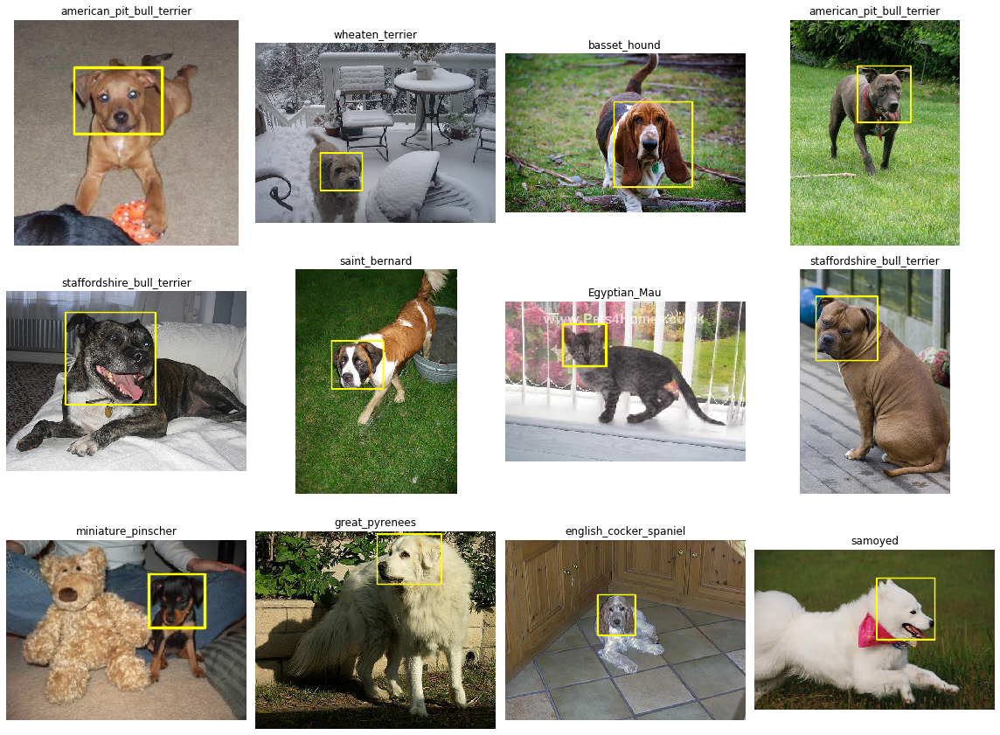

In [0]:
plot_df_images(df, 'file_path', 'breed')

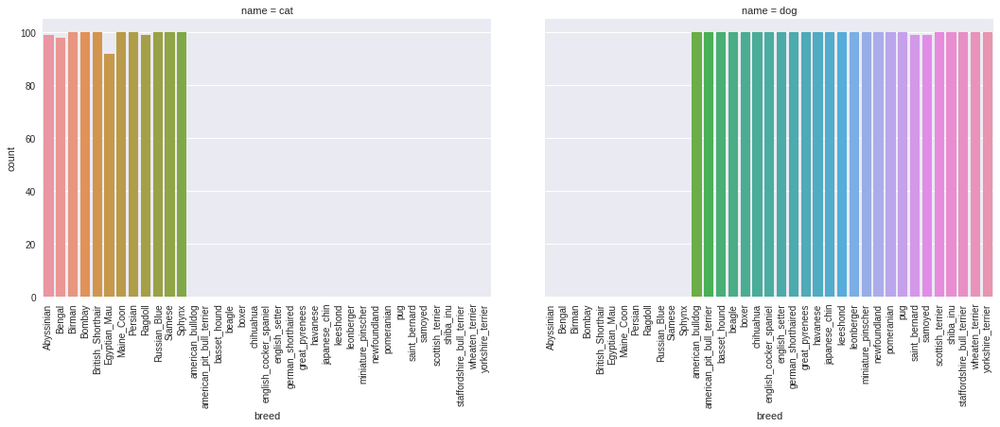

In [0]:
# Number of images in eacg breed
plt.style.use('seaborn')

g = sns.catplot(x='breed',
                col='name',
                data=df, aspect=1.5,
                kind='count',)
g.set_xticklabels(rotation=90)

## Data Preprocessing


In [0]:
BATCH_SIZE = 32
SHUFFLE_SIZE = 1024
IMG_DIMS = (299, 299, 3)
N_IMAGES = df.shape[0]

In [0]:
train_data, validation_data, test_data = split_df(df, 0.2, 'breed_encoded')

In [0]:
[df.shape for df in [train_data, validation_data, test_data]]

[(2948, 19), (369, 19), (369, 19)]

In [0]:
train_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            train_data['file_path'],
            tuple(
                [
                    train_data['breed_encoded'].values,
                    train_data[['x0', 'y0', 'object_width', 'object_height']].values,
                 train_data['name_encoded'].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .map(ImageAugmentor(level=3, rotate=False))
    .repeat()
    .shuffle(SHUFFLE_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
validation_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            validation_data['file_path'],
            tuple(
                [
                    validation_data['breed_encoded'].values,
                    validation_data[
                        ['x0', 'y0', 'object_width', 'object_height']
                    ].values,
                 validation_data['name_encoded'].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
test_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            test_data['file_path'],
            tuple(
                [
                    test_data['breed_encoded'].values,
                    test_data[['x0', 'y0', 'object_width', 'object_height']].values,
                 test_data['name_encoded'].values
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
def decode_category_name(transformer, category):
    category_name = transformer.inverse_transform([int(category)])
    category_name = ' '.join([str(elem) for elem in category_name])
    return category_name

In [0]:
def make_rectangle(x0, y0, width, height, img_dims, color, linewidth=3):
    return Rectangle(
        (x0 * img_dims[1], y0 * img_dims[0]),
        width * img_dims[1],
        height * img_dims[0],
        linewidth=linewidth,
        edgecolor=color,
        facecolor='none',
    )

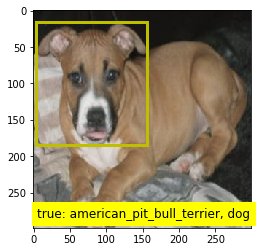

In [0]:
# Plotting sample image, true annotation, breed and name (cat/dog)
for x, y in train_set.take(1):
    n_image = 0
    categories, bounding_boxes, names = y
    category = categories[n_image].numpy()
    bounding_box = bounding_boxes[n_image].numpy()
    name = names[n_image].numpy()

    fig, ax = plt.subplots(1)
    ax.imshow(x[n_image].numpy())

    plt.text(5,
             IMG_DIMS[1]-15,
             f"true: {decode_category_name(le, category)}, {decode_category_name(le_name, name)}",
             backgroundcolor='yellow',
             fontsize=12,
    )
    y_rect = make_rectangle(*bounding_box, IMG_DIMS, 'y')
    ax.add_patch(y_rect)

In [0]:
n_categories = train_data['breed_encoded'].nunique()
n_categories

37

## Single Object Detector. Base Model - Xception

The model will have 3 outputs - breed, bounding box and name.

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
# We will have 3 outputs - breed, bounding box and name
def make_model():
    base = tf.keras.applications.Xception(
        input_shape=IMG_DIMS, include_top=False, weights='imagenet'
    )
    x = GlobalConcatPooling2D()(base.output)
    x = keras.layers.Dropout(0.4)(x)
    category = keras.layers.Dense(n_categories, activation=keras.activations.softmax, name='breed')(x)
    bounding_box = keras.layers.Dense(4, activation=keras.activations.sigmoid, name='bounding_box')(x)
    name = keras.layers.Dense(1, activation=keras.activations.sigmoid, name='name')(x)

    model = keras.Model(inputs=base.input, outputs=[category, bounding_box, name])
    model.compile(
        loss=[
            keras.losses.sparse_categorical_crossentropy,
            keras.losses.binary_crossentropy,
            keras.losses.binary_crossentropy,

        ],
        loss_weights=[0.5, 2.0, 1.0],
        optimizer=keras.optimizers.Adam(3e-4),
    )
    return model

In [0]:
model = make_model()

In [0]:
model.summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_11[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=20,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / 'xception_model1.h5'), save_best_only=True,
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=4, restore_best_weights=True),
    ],
)

Train for 93 steps, validate for 12 steps
Epoch 1/20
93/93 [==============================] - 83s 894ms/step - loss: 1.9329 - breed_loss: 1.1841 - bounding_box_loss: 0.6334 - name_loss: 0.0740 - val_loss: 1.4412 - val_breed_loss: 0.4170 - val_bounding_box_loss: 0.6115 - val_name_loss: 0.0097
Epoch 2/20
93/93 [==============================] - 70s 754ms/step - loss: 1.3073 - breed_loss: 0.2290 - bounding_box_loss: 0.5910 - name_loss: 0.0109 - val_loss: 1.3235 - val_breed_loss: 0.3677 - val_bounding_box_loss: 0.5675 - val_name_loss: 0.0047
Epoch 3/20
93/93 [==============================] - 70s 754ms/step - loss: 1.2086 - breed_loss: 0.1072 - bounding_box_loss: 0.5748 - name_loss: 0.0054 - val_loss: 1.2402 - val_breed_loss: 0.2555 - val_bounding_box_loss: 0.5550 - val_name_loss: 0.0026
Epoch 4/20
93/93 [==============================] - 70s 756ms/step - loss: 1.1605 - breed_loss: 0.0555 - bounding_box_loss: 0.5648 - name_loss: 0.0031 - val_loss: 1.2073 - val_breed_loss: 0.2151 - val_boun

In [0]:
def plot_b_predict(model, dataset, encoder1=le, encoder2=le_name, cols=4, rows = 3, batch_num=2):
    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i in range(cols*rows):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        for x, y in dataset.take(1):
            ax[idx].imshow(x[i].numpy())
            ax[idx].axis('off')
            p_categories, p_bounding_boxes, p_names = model.predict(x)
            p_category = p_categories[i].argmax()
            p_bounding_box = p_bounding_boxes[i]
            p_name = np.around(p_names[i]).astype(int)

            ax[idx].text(
                5,
                IMG_DIMS[1]-10,
                f"pred:{decode_category_name(encoder1, p_category)}, {decode_category_name(encoder2, p_name)}",
                color='white',
                backgroundcolor='magenta',
                fontsize=12,
            )
            p_rect = make_rectangle(*p_bounding_box, IMG_DIMS, 'm', 3)
            ax[idx].add_patch(p_rect)

            y_categories, y_bounding_boxes, y_names = y
            y_category = y_categories[i].numpy()
            y_bounding_box = y_bounding_boxes[i].numpy()
            y_name = y_names[i].numpy()

            
            y_rect = make_rectangle(*y_bounding_box, IMG_DIMS, 'y')
            ax[idx].add_patch(y_rect)
            ax[idx].text(
                5,
                IMG_DIMS[1]-50,
                f"true:{decode_category_name(encoder1, y_category)}, {decode_category_name(encoder2, y_name)} ",
                backgroundcolor='yellow',
                fontsize=12,
                )


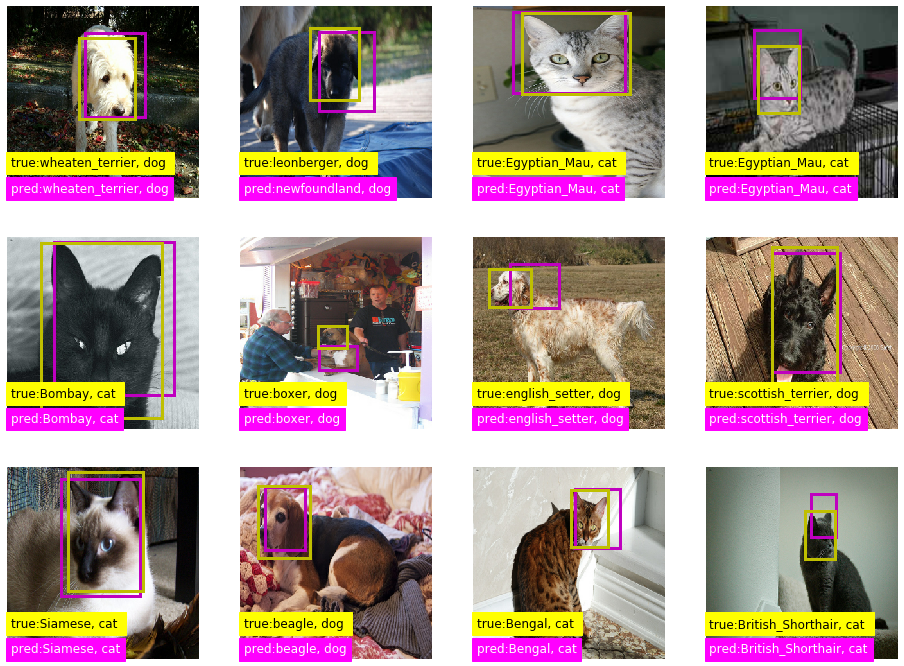

In [0]:
plot_b_predict(model, validation_set)

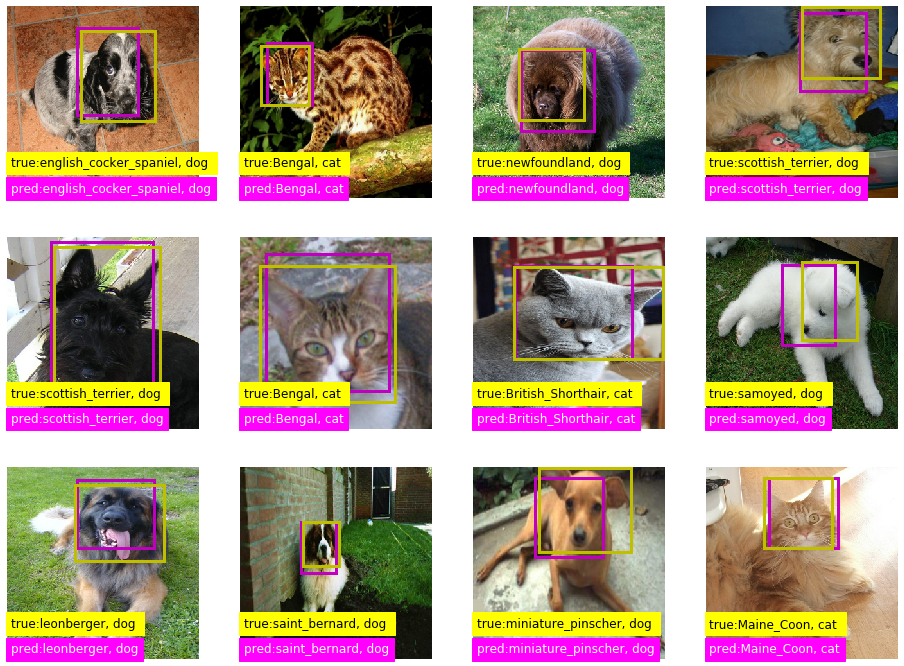

In [0]:
plot_b_predict(model, test_set)

In [0]:
def make_report(model, dataset, encoder=le):
        print(
            classification_report(
                [category.numpy() for _, (category, _, _) in dataset.unbatch()],
                model.predict(dataset)[0].argmax(axis=1),
                target_names=list(encoder.classes_),
            )
        )

In [0]:
make_report(model, validation_set, le)

                            precision    recall  f1-score   support

                Abyssinian       1.00      0.90      0.95        10
                    Bengal       0.89      0.80      0.84        10
                    Birman       0.83      1.00      0.91        10
                    Bombay       1.00      1.00      1.00        10
         British_Shorthair       0.91      1.00      0.95        10
              Egyptian_Mau       0.82      1.00      0.90         9
                Maine_Coon       1.00      0.90      0.95        10
                   Persian       0.91      1.00      0.95        10
                   Ragdoll       1.00      0.80      0.89        10
              Russian_Blue       1.00      0.90      0.95        10
                   Siamese       1.00      1.00      1.00        10
                    Sphynx       1.00      1.00      1.00        10
          american_bulldog       0.90      0.90      0.90        10
 american_pit_bull_terrier       0.89      0.80

In [0]:
make_report(model, test_set, le)

                            precision    recall  f1-score   support

                Abyssinian       1.00      0.80      0.89        10
                    Bengal       0.75      0.90      0.82        10
                    Birman       0.91      1.00      0.95        10
                    Bombay       1.00      1.00      1.00        10
         British_Shorthair       0.83      1.00      0.91        10
              Egyptian_Mau       1.00      0.89      0.94         9
                Maine_Coon       0.91      1.00      0.95        10
                   Persian       1.00      1.00      1.00        10
                   Ragdoll       0.91      1.00      0.95        10
              Russian_Blue       1.00      0.80      0.89        10
                   Siamese       1.00      0.80      0.89        10
                    Sphynx       1.00      1.00      1.00        10
          american_bulldog       0.69      0.90      0.78        10
 american_pit_bull_terrier       1.00      0.60

In [0]:
def analyse_dataset(model, dataset, verbose: int = 0):
    images = [x.numpy() for x, _ in dataset.unbatch()]
    probs = model.predict(dataset)[0]
    pred_code = probs.argmax(axis=1)
    label_code = [category.numpy() for _, (category, _, _) in dataset.unbatch()]
    return pd.DataFrame.from_dict(
        {
            'image': images,
            'label': label_code,
            'pred': pred_code,
            'label_probs': probs[:, label_code][np.eye(len(label_code), dtype=bool)],
            'pred_probs': probs[:, pred_code][np.eye(len(pred_code), dtype=bool)],
        }
    )

In [0]:
analyse_df = analyse_dataset(model, validation_set)

In [0]:
analyse_df

,image,label,pred,label_probs,pred_probs
0,"[[[0.13994354, 0.13811749, 0.09940019], [0.048...",35,35,0.939087,0.939087
1,"[[[0.2655646, 0.29255652, 0.32347003], [0.2967...",25,27,0.477965,0.496969
2,"[[[0.33488753, 0.4063901, 0.4445265], [0.33820...",5,5,0.998062,0.998062
3,"[[[0.23529413, 0.21176472, 0.023529414], [0.23...",5,5,0.995449,0.995449
4,"[[[0.7748028, 0.8140185, 0.81794006], [0.76349...",3,3,0.998542,0.998542
...,...,...,...,...,...
364,"[[[0.5343484, 0.5343484, 0.5343484], [0.54197,...",0,0,0.978660,0.978660
365,"[[[0.029245958, 0.059629224, 0.08432873], [0.0...",14,14,0.998427,0.998427
366,"[[[0.3068804, 0.26735258, 0.10296014], [0.3269...",1,1,0.566569,0.566569
367,"[[[0.51256174, 0.31109118, 0.13145007], [0.499...",30,30,0.999127,0.999127


In [0]:
analyse_df.to_csv(TEMP_DIR/'xception_model1_analyse_df.csv', index=False)

In [0]:
def show_predictions(
    model,
    dataset,
    encoder=le,
    correct: bool = False,
    ascending: bool = True,
    cols: int = 6,
    rows: int = 2,
):
    df = analyse_dataset(model, dataset)
    df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
    df.sort_values(by=['label_probs'], ascending=ascending, inplace=True)
    _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
    for i, row in enumerate(df.head(cols * rows).itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis('off')
        ax[idx].imshow(row.image)
        ax[idx].set_title(
            f"{decode_category_name(encoder, row.label)}\n{decode_category_name(encoder, row.pred)}\n{row.label_probs:.4f}:{row.pred_probs:.4f}"
        )

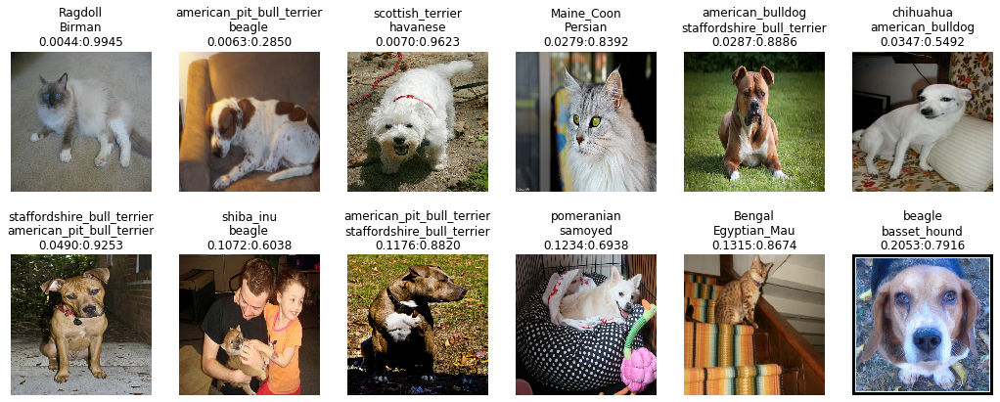

In [0]:
show_predictions(model, validation_set)

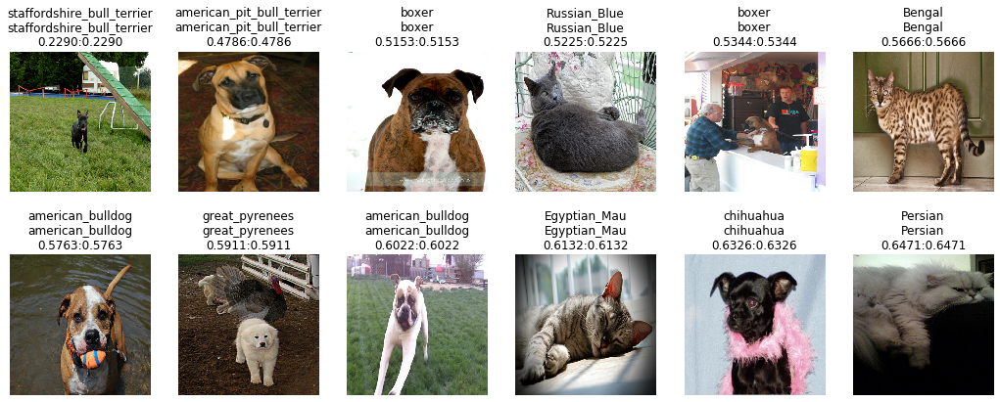

In [0]:
show_predictions(model, validation_set, correct=True)

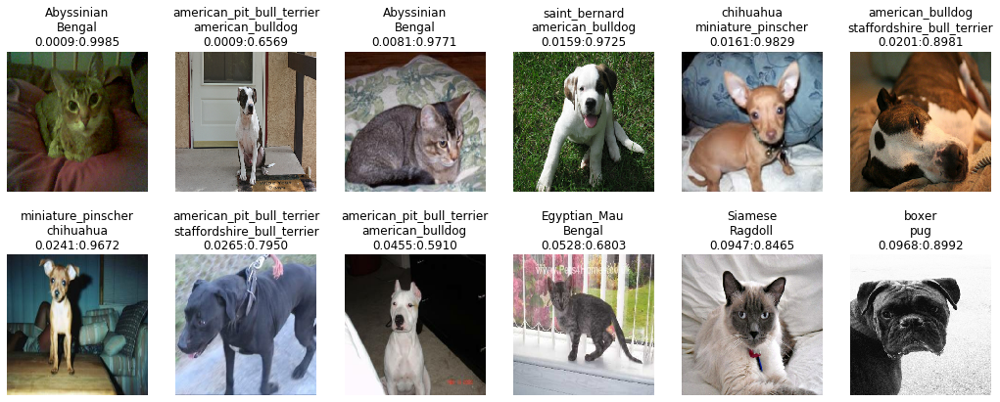

In [0]:
show_predictions(model, test_set)

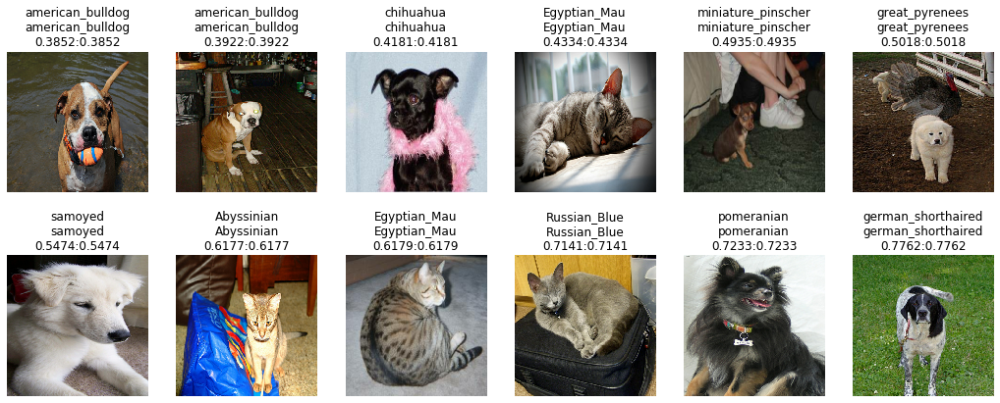

In [0]:
show_predictions(model, validation_set, correct=True)

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4, encoder=le):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, (labels, _, _) = next(iter(dataset))
    activation_maps = np.concatenate((activation_map_model.predict(images), activation_map_model.predict(images)), axis=3)
    class_probs, _, _ = model.predict(images)
    predictions = class_probs.argmax(-1)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-3].get_weights()[0][:, prediction]
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis('off')
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap='gist_ncar', alpha=0.4)

        ax[idx].set_title(decode_category_name(encoder, label.numpy()))

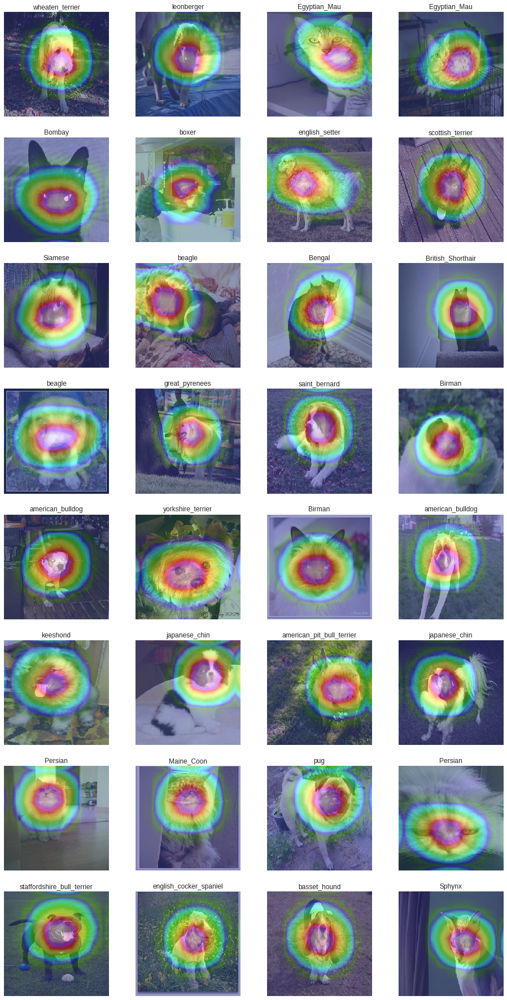

In [0]:
show_activation_maps(model, validation_set, 'block14_sepconv2_act')

## Single Object Detector. Base Model - MobileNetV2

The model will have 3 outputs - breed, bounding box and name.

In [0]:
BATCH_SIZE = 32
SHUFFLE_SIZE = 1024
IMG_DIMS = (224, 224, 3)
N_IMAGES = df.shape[0]

In [0]:
train_data, validation_data, test_data = split_df(df, 0.2, 'breed_encoded')

In [0]:
[df.shape for df in [train_data, validation_data, test_data]]

[(2948, 19), (369, 19), (369, 19)]

In [0]:
train_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            train_data['file_path'],
            tuple(
                [
                 train_data['breed_encoded'].values,
                 train_data[['x0', 'y0', 'object_width', 'object_height']].values,
                 train_data['name_encoded'].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .map(ImageAugmentor(level=3, rotate=False))
    .repeat()
    .shuffle(SHUFFLE_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
validation_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            validation_data['file_path'],
            tuple(
                [
                    validation_data['breed_encoded'].values,
                    validation_data[
                                    ['x0', 'y0', 'object_width', 'object_height']
                    ].values,
                 validation_data['name_encoded'].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
test_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            test_data['file_path'],
            tuple(
                [
                 test_data['breed_encoded'].values,
                 test_data[['x0', 'y0', 'object_width', 'object_height']].values,
                 test_data['name_encoded'].values
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, 'stretch'))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
# We will have 3 outputs - breed, bounding box and name

def make_model():
    base = tf.keras.applications.MobileNetV2(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet'
    )
    x = GlobalConcatPooling2D()(base.output)
    x = keras.layers.Dropout(0.4)(x)
    category = keras.layers.Dense(n_categories, activation=keras.activations.softmax, name='breed')(x)
    bounding_box = keras.layers.Dense(4, activation=keras.activations.sigmoid, name='bounding_box')(x)
    name = keras.layers.Dense(1, activation=keras.activations.sigmoid, name='name')(x)

    model = keras.Model(inputs=base.input, outputs=[category, bounding_box, name])
    model.compile(
        loss=[
            keras.losses.sparse_categorical_crossentropy,
            keras.losses.binary_crossentropy,
            keras.losses.binary_crossentropy,

        ],
        loss_weights=[0.5, 2.0, 1.0],
        optimizer=keras.optimizers.Adam(3e-4),
    )
    return model

In [0]:
model = make_model()

In [0]:
model.summary()

Model: "model_45"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_15[0][0]                   
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
___________________________________________________________________________________________

In [0]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0]/BATCH_SIZE),
    epochs=20,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR/'model_mobilenet_1.h5'), save_best_only=True,
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=4, restore_best_weights=True),
    ],
)

Train for 93 steps, validate for 12 steps
Epoch 1/20
93/93 [==============================] - 37s 399ms/step - loss: 3.8095 - breed_loss: 3.3176 - bounding_box_loss: 0.9616 - name_loss: 0.2276 - val_loss: 3.6692 - val_breed_loss: 2.1921 - val_bounding_box_loss: 1.2705 - val_name_loss: 0.0321
Epoch 2/20
93/93 [==============================] - 23s 250ms/step - loss: 1.9850 - breed_loss: 1.0207 - bounding_box_loss: 0.6987 - name_loss: 0.0773 - val_loss: 2.9605 - val_breed_loss: 1.2743 - val_bounding_box_loss: 1.1486 - val_name_loss: 0.0261
Epoch 3/20
93/93 [==============================] - 23s 243ms/step - loss: 1.6556 - breed_loss: 0.6210 - bounding_box_loss: 0.6553 - name_loss: 0.0344 - val_loss: 2.5351 - val_breed_loss: 0.9002 - val_bounding_box_loss: 1.0355 - val_name_loss: 0.0140
Epoch 4/20
93/93 [==============================] - 22s 235ms/step - loss: 1.5014 - breed_loss: 0.4507 - bounding_box_loss: 0.6275 - name_loss: 0.0211 - val_loss: 2.3193 - val_breed_loss: 0.9053 - val_boun

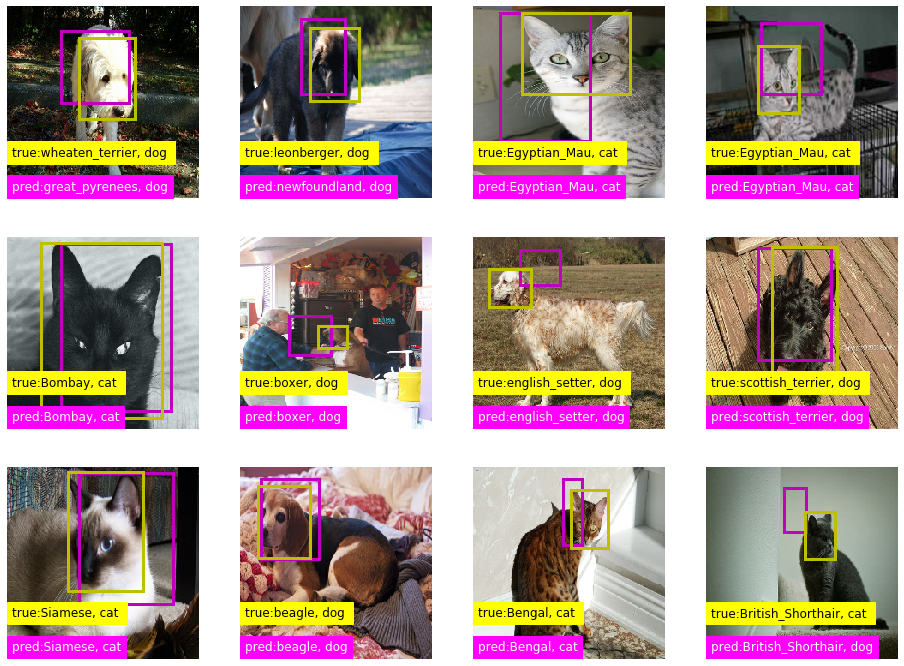

In [0]:
plot_b_predict(model, validation_set)

In [0]:
make_report(model, validation_set, le)

                            precision    recall  f1-score   support

                Abyssinian       1.00      0.70      0.82        10
                    Bengal       0.78      0.70      0.74        10
                    Birman       0.91      1.00      0.95        10
                    Bombay       1.00      0.90      0.95        10
         British_Shorthair       0.77      1.00      0.87        10
              Egyptian_Mau       0.73      0.89      0.80         9
                Maine_Coon       0.90      0.90      0.90        10
                   Persian       0.89      0.80      0.84        10
                   Ragdoll       1.00      0.90      0.95        10
              Russian_Blue       0.73      0.80      0.76        10
                   Siamese       1.00      1.00      1.00        10
                    Sphynx       0.91      1.00      0.95        10
          american_bulldog       0.80      0.80      0.80        10
 american_pit_bull_terrier       0.64      0.90

In [0]:
make_report(model, test_set, le)

                            precision    recall  f1-score   support

                Abyssinian       0.89      0.80      0.84        10
                    Bengal       0.73      0.80      0.76        10
                    Birman       1.00      0.90      0.95        10
                    Bombay       1.00      1.00      1.00        10
         British_Shorthair       0.91      1.00      0.95        10
              Egyptian_Mau       0.89      0.89      0.89         9
                Maine_Coon       1.00      0.90      0.95        10
                   Persian       1.00      1.00      1.00        10
                   Ragdoll       0.77      1.00      0.87        10
              Russian_Blue       1.00      0.90      0.95        10
                   Siamese       1.00      0.90      0.95        10
                    Sphynx       1.00      1.00      1.00        10
          american_bulldog       0.83      1.00      0.91        10
 american_pit_bull_terrier       0.62      0.80

In [0]:
analyse_mobilenet_df = analyse_dataset(model, validation_set)

In [0]:
analyse_mobilenet_df

,image,label,pred,label_probs,pred_probs
0,"[[[0.10584632, 0.101373516, 0.06347961], [0.06...",35,21,0.176766,0.624501
1,"[[[0.2704563, 0.29598153, 0.3254283], [0.30381...",25,27,0.013914,0.984482
2,"[[[0.34000352, 0.40507096, 0.44004387], [0.344...",5,5,0.999912,0.999912
3,"[[[0.23543419, 0.21190478, 0.02366947], [0.240...",5,5,0.999733,0.999733
4,"[[[0.76662904, 0.8058447, 0.8097663], [0.75883...",3,3,0.996345,0.996345
...,...,...,...,...,...
364,"[[[0.53618824, 0.53618824, 0.53618824], [0.529...",0,0,0.995907,0.995907
365,"[[[0.034292236, 0.067307785, 0.09288685], [0.0...",14,14,0.999931,0.999931
366,"[[[0.3118342, 0.2783373, 0.11412542], [0.31071...",1,5,0.080927,0.917417
367,"[[[0.512496, 0.3097103, 0.12670553], [0.506239...",30,30,0.999979,0.999979


In [0]:
analyse_df.to_csv(TEMP_DIR/'analyse_mobilenet_df.csv', index=False)

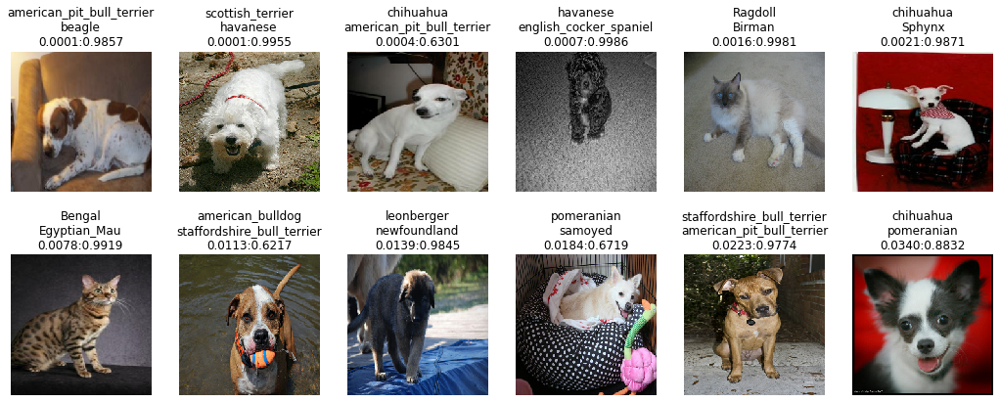

In [0]:
show_predictions(model, validation_set)

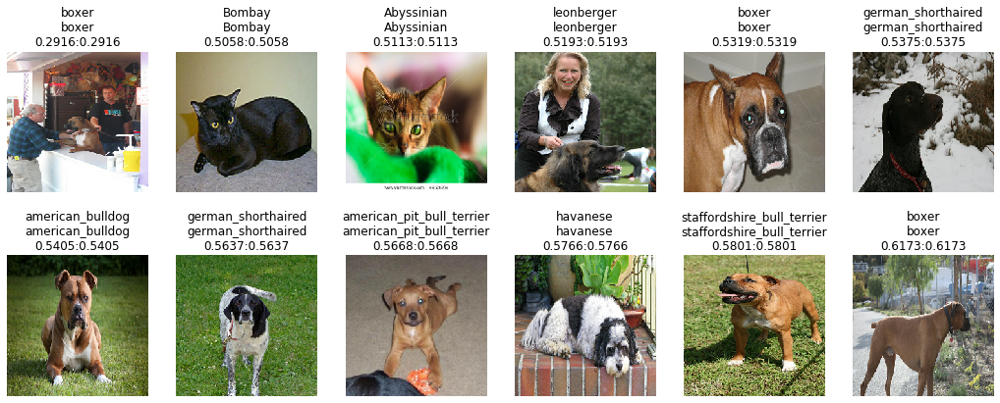

In [0]:
show_predictions(model, validation_set, correct=True)

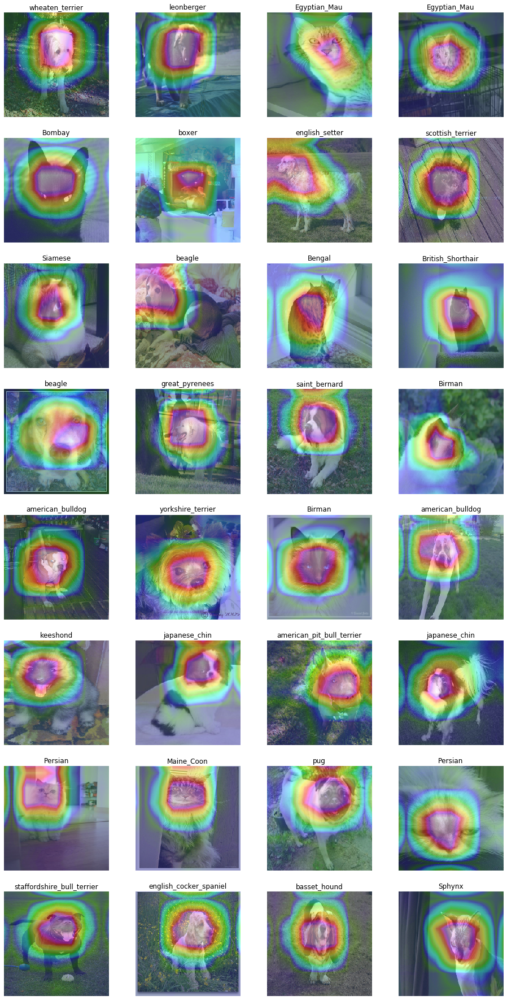

In [0]:
show_activation_maps(model, validation_set, 'out_relu')

## Keras RetinaNet (Single/Multiple Object Detection)

### Setup

In [0]:
!git clone https://github.com/fizyr/keras-retinanet.git

In [0]:
!pip install -q -U tensorflow-gpu==2.0

In [0]:
!pip install --upgrade keras

In [0]:
%cd /content/keras-retinanet

In [0]:
!pip install .

In [0]:
!python setup.py build_ext --inplace

In [0]:
!pip install tensorflow-gpu==2.0

In [0]:
import csv
import cv2

from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.colors import label_color

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

In [0]:
%config InlineBackend.figure_format='retina'

In [0]:
print(__import__('tensorflow').__version__)

2.0.0


### Preparing Dataset

In [0]:
breeds = list(le.classes_)

In [0]:
breeds_encoded = list(le.fit_transform(breeds))

In [0]:
classes = pd.DataFrame(list(zip(breeds, breeds_encoded)), index=None)

In [0]:
classes.to_csv(TEMP_DIR/'classes.csv', index=False, header=False)

In [0]:
annotations_df = df[['file_path', 'xmin', 'ymin', 'xmax', 'ymax', 'breed']].copy()

In [0]:
annotations_df['file_path'] = '/content/' + annotations_df['file_path'].astype(str)

In [0]:
annotations_df.to_csv('annotations.csv', index=False, header=False)

In [0]:
annotations_ret = pd.read_csv(TEMP_DIR/'annotations.csv', names=['file_path', 'xmin', 'ymin', 'xmax', 'ymax', 'breed'])

In [0]:
train_data_ret, validation_data_ret, test_data_ret = split_df(annotations_ret, 0.2, 'breed')

In [0]:
train_data_ret.to_csv(TEMP_DIR/'train_data_ret.csv', index=False, header=False)

In [0]:
validation_data_ret.to_csv(TEMP_DIR/'validation_data_ret.csv', index=False, header=False)

In [0]:
test_data_ret.to_csv(TEMP_DIR/'test_data_ret.csv', index=False, header=False)

In [0]:
!cp $TEMP_DIR/classes.csv .

In [0]:
!cp $TEMP_DIR/train_data_ret.csv .

In [0]:
!cp $TEMP_DIR/validation_data_ret.csv .

In [0]:
!cp $TEMP_DIR/test_data_ret.csv .

In [0]:
!head train_data_ret.csv

/content/data/pets/beagle_186.jpg,215,152,375,297,beagle
/content/data/pets/great_pyrenees_100.jpg,133,57,276,210,great_pyrenees
/content/data/pets/Russian_Blue_114.jpg,187,76,299,186,Russian_Blue
/content/data/pets/Maine_Coon_197.jpg,92,53,219,189,Maine_Coon
/content/data/pets/basset_hound_119.jpg,33,11,250,232,basset_hound
/content/data/pets/chihuahua_166.jpg,112,1,197,114,chihuahua
/content/data/pets/beagle_113.jpg,15,118,275,395,beagle
/content/data/pets/boxer_130.jpg,95,1,390,245,boxer
/content/data/pets/shiba_inu_136.jpg,139,106,228,216,shiba_inu
/content/data/pets/beagle_192.jpg,158,68,373,226,beagle


In [0]:
!head classes.csv

Abyssinian,0
Bengal,1
Birman,2
Bombay,3
British_Shorthair,4
Egyptian_Mau,5
Maine_Coon,6
Persian,7
Ragdoll,8
Russian_Blue,9


### Training Keras RetinaNet

In [0]:
os.makedirs('snapshots', exist_ok=True)

In [0]:
PRETRAINED_MODEL = './snapshots/_pretrained_model.h5'

URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

print('Downloaded pretrained model to ' + PRETRAINED_MODEL)


Downloaded pretrained model to ./snapshots/_pretrained_model.h5


In [0]:
!keras_retinanet/bin/train.py \
 --freeze-backbone \
 --random-transform \
 --weights {PRETRAINED_MODEL} \
 --batch-size 8 \
 --steps 500 \
 --epochs 15 \
 csv annotations.csv classes.csv

Using TensorFlow backend.
Creating model, this may take a second...
2020-02-03 09:08:02.045591: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-02-03 09:08:02.090351: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1006] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-02-03 09:08:02.090924: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1618] Found device 0 with properties: 
name: Tesla P100-PCIE-16GB major: 6 minor: 0 memoryClockRate(GHz): 1.3285
pciBusID: 0000:00:04.0
2020-02-03 09:08:02.099956: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.0
2020-02-03 09:08:02.274914: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10.0
2020-02-03 09:08:02.370460: I tensorflow/stream_executor/platfo

We continued training the model to increase performance. 

We repeated it for a few times. 

Total number of epochs the model was trained - 45. 


Bellow you can see results of final training.

In [0]:
PRETRAINED_MODEL = './snapshots/resnet50_csv_09.h5'

In [0]:
!keras_retinanet/bin/train.py \
 --freeze-backbone \
 --random-transform \
 --weights {PRETRAINED_MODEL} \
 --batch-size 8 \
 --steps 500 \
 --epochs 10 \
 csv train_data_ret.csv classes.csv

Using TensorFlow backend.
Creating model, this may take a second...
2020-02-04 13:11:04.214812: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-02-04 13:11:04.227337: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1006] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-02-04 13:11:04.227917: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1618] Found device 0 with properties: 
name: Tesla P100-PCIE-16GB major: 6 minor: 0 memoryClockRate(GHz): 1.3285
pciBusID: 0000:00:04.0
2020-02-04 13:11:04.228192: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.0
2020-02-04 13:11:04.229205: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10.0
2020-02-04 13:11:04.230174: I tensorflow/stream_executor/platfo

Results of the final training:

```
loss: 0.7086 - regression_loss: 0.4968 - classification_loss: 0.2118

```

In [0]:
model_path_cp = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
print(model_path_cp)

snapshots/resnet50_csv_10.h5


In [0]:
!cp $model_path_cp $TEMP_DIR

### Loading Final Trained Model

In [0]:
CLASSES_FILE = 'classes.csv'

In [0]:
model_path = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
print(model_path)

model = models.load_model(model_path, backbone_name='resnet50')
model = models.convert_model(model)

labels_to_names = pd.read_csv(CLASSES_FILE, header=None).T.loc[0].to_dict()

snapshots/resnet50_csv_10.h5
tracking <tf.Variable 'Variable:0' shape=(9, 4) dtype=float32, numpy=
array([[-22.627417, -11.313708,  22.627417,  11.313708],
       [-28.50876 , -14.25438 ,  28.50876 ,  14.25438 ],
       [-35.918785, -17.959393,  35.918785,  17.959393],
       [-16.      , -16.      ,  16.      ,  16.      ],
       [-20.158737, -20.158737,  20.158737,  20.158737],
       [-25.398417, -25.398417,  25.398417,  25.398417],
       [-11.313708, -22.627417,  11.313708,  22.627417],
       [-14.25438 , -28.50876 ,  14.25438 ,  28.50876 ],
       [-17.959393, -35.918785,  17.959393,  35.918785]], dtype=float32)> anchors
tracking <tf.Variable 'Variable:0' shape=(9, 4) dtype=float32, numpy=
array([[-45.254833, -22.627417,  45.254833,  22.627417],
       [-57.01752 , -28.50876 ,  57.01752 ,  28.50876 ],
       [-71.83757 , -35.918785,  71.83757 ,  35.918785],
       [-32.      , -32.      ,  32.      ,  32.      ],
       [-40.317474, -40.317474,  40.317474,  40.317474],
       [

### Plotting Single Object Detections

In [0]:
def predict(image, model=model):
  image = preprocess_image(image.copy())
  image, scale = resize_image(image)

  boxes, scores, labels = model.predict_on_batch(
    np.expand_dims(image, axis=0)
  )

  boxes /= scale

  return boxes, scores, labels

In [0]:
def plot_retinanet_predict(dataset, cols=4, rows = 3):
    f, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i in range(cols*rows):
        rand_int = np.random.randint(len(dataset))
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        image_row = dataset.iloc[rand_int]
        img_path = image_row.file_path

        image = read_image_bgr(img_path)

        boxes, scores, labels = predict(image)

        draw = image.copy()
        draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

        true_box = [
            image_row.xmin, image_row.ymin, image_row.xmax, image_row.ymax
        ]
        draw_box(draw, true_box, color=(255, 255, 0))

        ax[idx].text(
            5,
            image.shape[0]*0.9,
            f'true: {image_row.breed}',
            backgroundcolor='yellow',
            fontsize=12,)
        
        box, score, label = boxes[0][0], scores[0][0], labels[0][0]

        b = box.astype(int)

        draw_box(draw, b, color=(255,0,255))

        caption = 'pred: {} {:.3f}'.format(labels_to_names[label], score)
        ax[idx].text(
            5,
            image.shape[0]+5,
            caption,
            backgroundcolor='magenta',
            fontsize=12,)
        
        ax[idx].imshow(draw)
        ax[idx].axis('off')
        plt.tight_layout()
       

In [0]:
test_data_ret = pd.read_csv('test_data_ret.csv', names=['file_path', 'xmin', 'ymin', 'xmax', 'ymax', 'breed'])

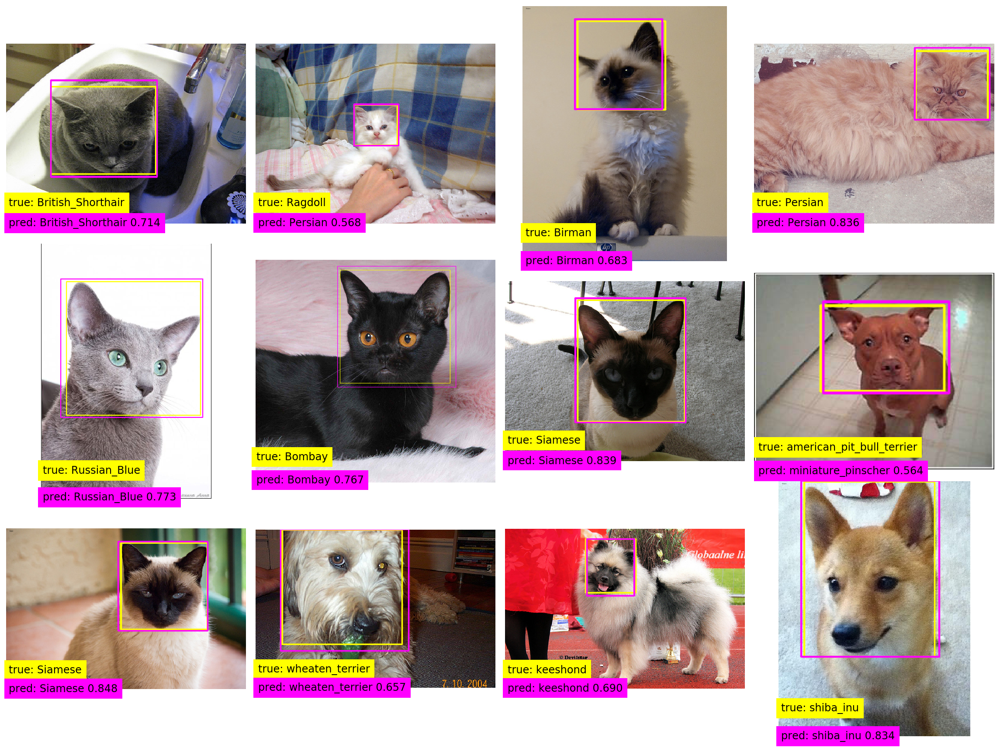

In [0]:
plot_retinanet_predict(test_data_ret)

### Plotting Multiple Objects Detections

We will plot detections on images containing multiple objects.

In [0]:
def draw_caption_mult(image, box, caption, color):
    b = np.array(box).astype(int)
    cv2.putText(image, caption, (b[0], b[1]-10), cv2.FONT_HERSHEY_PLAIN, 1, color, 2)

In [0]:
def plot_mult_objects(url):

    filename = os.path.basename(url)
    image_path = keras.utils.get_file(filename, url)
    image = read_image_bgr(image_path)

    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

    image = preprocess_image(image)
    image, scale = resize_image(image)

    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))

    boxes /= scale

    for box, score, label in zip(boxes[0], scores[0], labels[0]):
        if score < 0.5:
            break
            
        color = label_color(label)
        
        b = box.astype(int)
        draw_box(draw, b, color=color)
        
        caption = '{} {:.3f}'.format(labels_to_names[label], score)
        draw_caption_mult(draw, b, caption,color)
        
    plt.figure(figsize=(15, 10))
    plt.axis('off')
    plt.imshow(draw)

In [0]:
image_urls = ['https://www.massapequaobserver.com/wp-content/uploads/2016/04/MassCal_040616C.jpg',
             'https://thumbs.dreamstime.com/b/group-dogs-cats-front-white-background-60529304.jpg',
              'https://img.huffingtonpost.com/asset/5cd35d172300005600b76502.jpeg?ops=1200_630']

[None, None, None]

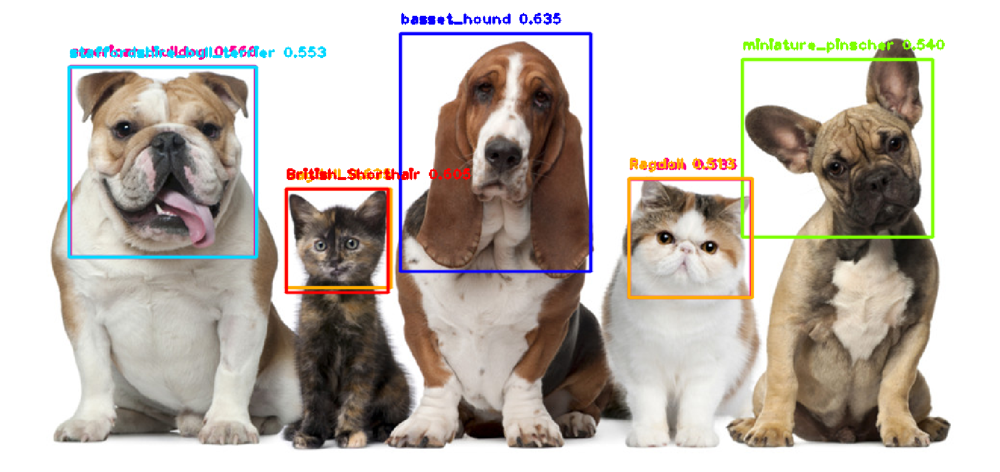

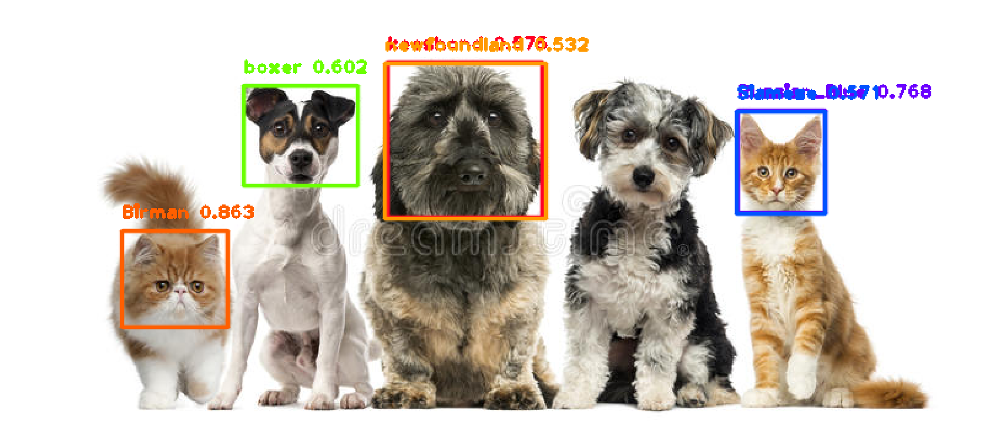

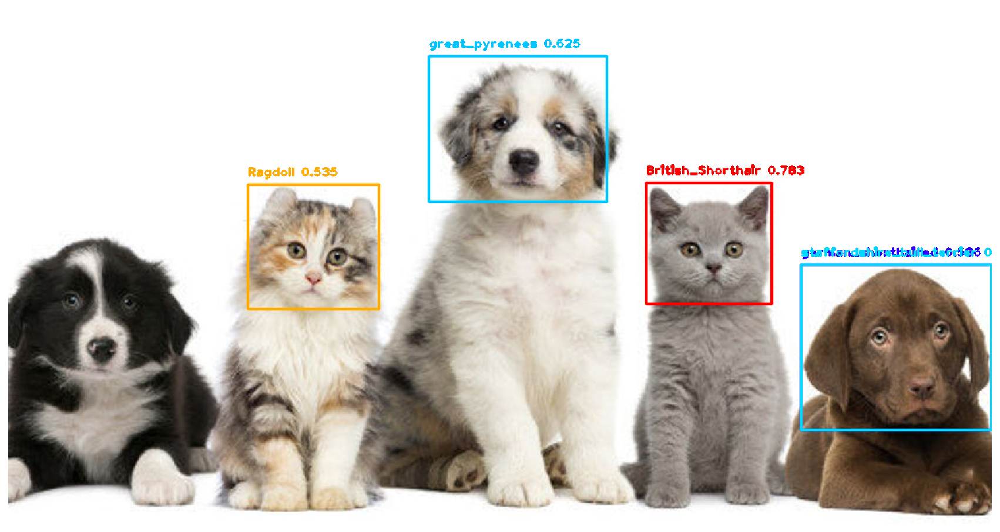

In [0]:
# As provided in the dataset - cat breeds start in upper case, dog breeds - in lower case
[plot_mult_objects(image_url) for image_url in image_urls]

The model did not detect breeds which were not in training data set.

We could train the model for more epoch to achieve better results in detecting breeds provided in the data.